# Matrix Factorization: Experiments and Evaluation

This notebook implements and compares two classical MF recommendation paradigms:
1. **FunkSVD**
2. **Alternative Least Squares (ALS)**

Both model use low-rank approximation for user-ratings matrix, but differ in optimization strategy: FunkSVD uses stochastic gradient descent (SGD) to iteratively update user- and item- matrix parameters on each epoch, while ALS iteratively fixes one matrix, solves ridge regression for second matrix, then fixes second matrix and solves for the first one until convergence. We use explicit implementations of these algorithm, meaning we try to predict rating of the item. 

In [1]:
import sys
sys.path.append('..')

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import time

from src.data.loader import load_all_data
from src.data.splitter import create_temporal_split, SplitConfig, add_random_timestamps, UserTemporalSplitConfig
from src.models import ContentBasedRecommender, ItemItemCFRecommender, FunkSVD, FunkSVDConfig, ALS, ALSConfig
from src.evaluation import (
    EvaluationPipeline,
    GlobalMeanBaseline,
    UserMeanBaseline,
    ItemMeanBaseline,
    PopularityBaseline,
    print_evaluation_results,
)

plt.style.use('seaborn-v0_8-whitegrid')
%matplotlib inline

## 1. Data Loading and Temporal Split

For this task temporal split we use differs from similarity recommendation algorithms. If we split by the year the book was published, matrix factorization inherently make no sense, as all of the validation and test books will face cold start problem. Therefore we create random variable timestamp, that simulates time the book was rated. Then, for each user we order ratings by timestamp and split train/val/test with 0.7/0.15/0.15 ratio, so that older books go in train and newer into validation and test. This creates simulation of temporal data.

In [2]:
# Load data
ratings, books, users = load_all_data('../data/raw')

ratings_ts = add_random_timestamps(ratings, start="2004-08-01", end="2004-09-30", seed=123, ts_col="timestamp")



In [ ]:
# Initialize evaluation pipeline
K_VALUES = [5, 10, 20]
pipeline = EvaluationPipeline(k_values=K_VALUES, relevance_threshold=6)

# Store all results
all_results = {}

## 2. Baseline Models

We first establish baselines to compare against.

In [30]:
# Create temporal split
config = UserTemporalSplitConfig(
    train_frac=0.7,
    val_frac=0.15,
    test_frac=0.15,
    min_train=1,
    min_val=1,
    min_test=1,
    min_user_interactions = 5,
    min_item_interactions = 5,
    explicit_only = True
)

train_df, val_df, test_df, split_info = create_temporal_split(ratings_ts, books, "users", config)


--- Step 1: Filtering data ---
Original ratings: 1,149,780
After explicit filter: 433,671 ratings
After year filter (1900-2004): 377,822 ratings
Iteration 1: 134,016 ratings, 11,966 users, 10,522 items
Iteration 2: 116,166 ratings, 7,134 users, 9,145 items
Iteration 3: 114,616 ratings, 6,842 users, 9,026 items
Iteration 4: 114,430 ratings, 6,812 users, 9,006 items
Iteration 5: 114,373 ratings, 6,804 users, 8,999 items
Iteration 6: 114,354 ratings, 6,802 users, 8,996 items
Iteration 7: 114,334 ratings, 6,800 users, 8,993 items
Iteration 8: 114,326 ratings, 6,799 users, 8,992 items
Iteration 9: 114,295 ratings, 6,796 users, 8,987 items
Iteration 10: 114,279 ratings, 6,794 users, 8,985 items
Iteration 11: 114,271 ratings, 6,792 users, 8,985 items
Iteration 12: 114,271 ratings, 6,792 users, 8,985 items

--- Step 2: Temporal split ---
Initial split sizes (by user timestamp):
  Train: 74,782 ratings
  Val: 15,626 ratings
  Test: 23,863 ratings

--- Step 3: Ensuring test users have training 

In [31]:
# Global Mean Baseline
global_mean = GlobalMeanBaseline()
global_mean.fit(train_df)
all_results['Global Mean'] = pipeline.evaluate_rating_prediction(global_mean, test_df)
print(f"Global Mean → RMSE: {all_results['Global Mean']['rmse']:.4f}, MAE: {all_results['Global Mean']['mae']:.4f}")

# User Mean Baseline
user_mean = UserMeanBaseline()
user_mean.fit(train_df)
all_results['User Mean'] = pipeline.evaluate_rating_prediction(user_mean, test_df)
print(f"User Mean  → RMSE: {all_results['User Mean']['rmse']:.4f}, MAE: {all_results['User Mean']['mae']:.4f}")

# Item Mean Baseline
item_mean = ItemMeanBaseline()
item_mean.fit(train_df)
all_results['Item Mean'] = pipeline.evaluate_rating_prediction(item_mean, test_df)
print(f"Item Mean  → RMSE: {all_results['Item Mean']['rmse']:.4f}, MAE: {all_results['Item Mean']['mae']:.4f}")

Global Mean → RMSE: 1.7820, MAE: 1.4080
User Mean  → RMSE: 1.6453, MAE: 1.2395
Item Mean  → RMSE: 1.8142, MAE: 1.4228


## 3. Alternative Least Squares

### 3.1 Users with minimum 5 interactions

In [46]:
# Create temporal split
config = UserTemporalSplitConfig(
    train_frac=0.7,
    val_frac=0.15,
    test_frac=0.15,
    min_train=1,
    min_val=1,
    min_test=1,
    min_user_interactions = 5,
    min_item_interactions = 5,
    explicit_only = True
)

train_df, val_df, test_df, split_info = create_temporal_split(ratings_ts, books, "users", config)
train_df = pd.concat([train_df, val_df], axis=0, ignore_index=True)


--- Step 1: Filtering data ---
Original ratings: 1,149,780
After explicit filter: 433,671 ratings
After year filter (1900-2004): 377,822 ratings
Iteration 1: 134,016 ratings, 11,966 users, 10,522 items
Iteration 2: 116,166 ratings, 7,134 users, 9,145 items
Iteration 3: 114,616 ratings, 6,842 users, 9,026 items
Iteration 4: 114,430 ratings, 6,812 users, 9,006 items
Iteration 5: 114,373 ratings, 6,804 users, 8,999 items
Iteration 6: 114,354 ratings, 6,802 users, 8,996 items
Iteration 7: 114,334 ratings, 6,800 users, 8,993 items
Iteration 8: 114,326 ratings, 6,799 users, 8,992 items
Iteration 9: 114,295 ratings, 6,796 users, 8,987 items
Iteration 10: 114,279 ratings, 6,794 users, 8,985 items
Iteration 11: 114,271 ratings, 6,792 users, 8,985 items
Iteration 12: 114,271 ratings, 6,792 users, 8,985 items

--- Step 2: Temporal split ---
Initial split sizes (by user timestamp):
  Train: 74,782 ratings
  Val: 15,626 ratings
  Test: 23,863 ratings

--- Step 3: Ensuring test users have training 

In [47]:
train_items = set(train_df['isbn'].unique())
test_items = set(test_df['isbn'].unique())
overlap = train_items & test_items

print("TEMPORAL SPLIT")
print("=" * 50)
print(f"Train items: {len(train_items):,}")
print(f"Test items: {len(test_items):,}")
print(f"Overlap (items in both): {len(overlap)}")

# Shared users
train_users = set(train_df['user_id'].unique())
test_users = set(test_df['user_id'].unique())
shared_users = train_users & test_users
print(f"\nShared users (in both train and test): {len(shared_users):,}")
print(f"Test-only users: {len(test_users - train_users):,}")

TEMPORAL SPLIT
Train items: 8,985
Test items: 7,504
Overlap (items in both): 7504

Shared users (in both train and test): 6,792
Test-only users: 0


## Implicit style


In [48]:
from datetime import datetime
today = datetime.strptime('2004-09-30 00:12:53', "%Y-%m-%d %H:%M:%S")


In [49]:
h = 30
train_df['implicit_style'] = np.where(train_df['rating'] != 0, 1, 0)
train_df['delta_t'] = (today - train_df['timestamp']).dt.total_seconds()/(3600*24)
train_df['decay'] = 2**(-train_df['delta_t']/h)
train_df['score'] = train_df['decay']*train_df['implicit_style']
items_scores_grouped = train_df[['isbn', 'score']].groupby(['isbn']).sum('score').sort_values(by = 'score', ascending = False).reset_index()

In [50]:
items_scores_grouped['isbn']

0       0316666343
1       0385504209
2       0312195516
3       0142001740
4       0060928336
           ...    
8980    0778320286
8981    0142000485
8982    0385318294
8983    0345433300
8984    0140255109
Name: isbn, Length: 8985, dtype: object

In [51]:
# Evaluate FunkSVD - Ranking
print("Evaluating ranking (this may take a few minutes)...")
t0 = time.time()
heuristics_ranking = pipeline.evaluate_ranking_heuristic(items_scores_grouped['isbn'], test_df, train_df, n_recommendations=10)
print(f"  NDCG@10:     {heuristics_ranking.get('ndcg@10', 0):.4f}")
print(f"  Precision@10: {heuristics_ranking.get('precision@10', 0):.4f}")
print(f"  Hit Rate@10:  {heuristics_ranking.get('hit_rate@10', 0):.4f}")
print(f"  Users eval'd: {heuristics_ranking.get('users_evaluated', 0)}")
print(f"  Time: {time.time()-t0:.1f}s")

# Merge results
#all_results['ALS_min10'] = {**als_rating, **als_model_ranking}

Evaluating ranking (this may take a few minutes)...
test_df len 6792
0
user_relevant len 6792
6792
  NDCG@10:     0.0160
  Precision@10: 0.0069
  Hit Rate@10:  0.0658
  Users eval'd: 6792
  Time: 2.9s


In [38]:
# Evaluate FunkSVD - Ranking
print("Evaluating ranking (this may take a few minutes)...")
t0 = time.time()
heuristics_ranking = pipeline.evaluate_ranking_heuristic(items_scores_grouped['isbn'], test_df, train_df, n_recommendations=10)
print(f"  NDCG@10:     {heuristics_ranking.get('ndcg@10', 0):.4f}")
print(f"  Precision@10: {heuristics_ranking.get('precision@10', 0):.4f}")
print(f"  Hit Rate@10:  {heuristics_ranking.get('hit_rate@10', 0):.4f}")
print(f"  Users eval'd: {heuristics_ranking.get('users_evaluated', 0)}")
print(f"  Time: {time.time()-t0:.1f}s")

# Merge results
#all_results['ALS_min10'] = {**als_rating, **als_model_ranking}

Evaluating ranking (this may take a few minutes)...
test_df len 6792
0
user_relevant len 6792
6792
  NDCG@10:     0.0160
  Precision@10: 0.0069
  Hit Rate@10:  0.0664
  Users eval'd: 6792
  Time: 2.9s


In [93]:
items_scores_grouped[items_scores_grouped['score'] != 0].sort_values(by = 'score', ascending = False).head(500)

,isbn,score
5270,0316666343,126.245944
12119,0385504209,104.998592
4100,0312195516,73.355453
32419,0971880107,67.752738
3309,0142001740,63.385529
...,...,...
5259,0316603287,11.374086
18305,0451203771,11.366164
24335,0671250671,11.305082
4943,0312980159,11.289939


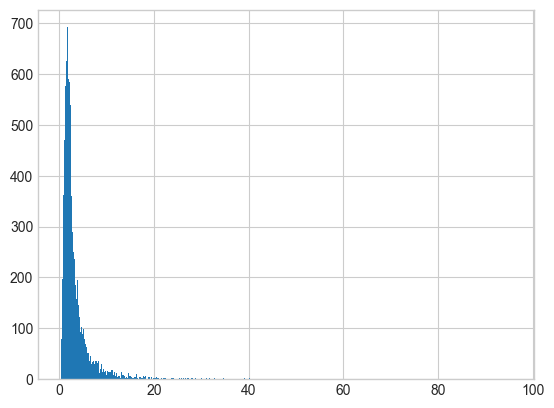

In [39]:
plt.hist(items_scores_grouped[items_scores_grouped['score'] > 0]['score'], bins = 500)
plt.show()

In [ ]:
books[books['isbn'] == '0316666343']

,isbn,title,author,year,publisher
408,0316666343,The Lovely Bones: A Novel,Alice Sebold,2002.0,"Little, Brown"


In [45]:
train_df[train_df['isbn'] == '0316666343']
train_df[train_df['user_id'] == '99996']

,user_id,isbn,rating,timestamp,year,implicit_style,delta_t,decay,score
148577,99996,0446613061,3,2004-08-22 01:24:38.559721118,2003.0,1,38.950167,0.406594,0.406594
148573,99996,0440235162,8,2004-08-22 21:35:15.125973092,2002.0,1,38.109466,0.414569,0.414569
148576,99996,0440241073,7,2004-08-22 23:41:00.639783932,2002.0,1,38.022134,0.415406,0.415406
148581,99996,0553578316,7,2004-08-24 03:03:18.339408095,2002.0,1,36.881651,0.426498,0.426498
148569,99996,006103083X,5,2004-08-31 03:19:56.006603449,2000.0,1,29.870104,0.501503,0.501503
148572,99996,0425179613,7,2004-09-08 16:22:48.108644613,2001.0,1,21.326446,0.610947,0.610947
148578,99996,0446675776,8,2004-09-10 14:00:45.660578593,2001.0,1,19.425085,0.638384,0.638384
148570,99996,0140088393,8,2004-09-21 18:07:10.561203567,1986.0,1,8.253963,0.826375,0.826375


## Graph based approach

In [52]:
from collections import Counter
from itertools import combinations

user_items = train_df.groupby("user_id")["isbn"].apply(lambda x: pd.unique(x).tolist())

pair_cnt = Counter()
item_cnt = Counter()

for items in user_items:
    # count item degrees (#users per item)
    for i in items:
        item_cnt[i] += 1
    # co-occurrence pairs
    for i, j in combinations(sorted(items), 2):
        pair_cnt[(i, j)] += 1

In [61]:
from math import sqrt
from collections import defaultdict

neighbors = defaultdict(list)  

for (i, j), cij in pair_cnt.items():
    sim = cij / sqrt(item_cnt[i] * item_cnt[j])
    neighbors[i].append((j, sim))
    neighbors[j].append((i, sim))

In [74]:
M = 200  # try 50–500 depending on size

for i in list(neighbors.keys()):
    neighbors[i].sort(key=lambda x: x[1], reverse=True)
    neighbors[i] = neighbors[i][:M]

In [75]:
train_df

,user_id,isbn,rating,timestamp,year,implicit_style,delta_t,decay,score
0,276964,0684867621,8,2004-08-08 14:59:21.740388106,1999.0,1,52.384390,0.298097,0.298097
1,276964,0886774829,8,2004-08-11 20:06:03.614297812,1994.0,1,49.171405,0.321069,0.321069
2,276964,0345354621,10,2004-08-11 21:43:05.385151974,1988.0,1,49.104023,0.321569,0.321569
3,276964,0886775957,10,2004-08-12 01:35:14.898064119,1994.0,1,48.942802,0.322769,0.322769
4,276964,0886774802,8,2004-08-15 19:35:12.856246513,1994.0,1,45.192826,0.351982,0.351982
...,...,...,...,...,...,...,...,...,...
90403,276680,0385503857,8,2004-09-22 07:45:51.354427233,2003.0,1,7.685436,0.837301,0.837301
90404,276680,0385504209,8,2004-09-22 10:30:25.074880744,2003.0,1,7.571157,0.839515,0.839515
90405,276681,0060809833,10,2004-08-17 07:31:22.742455263,1989.0,1,43.695489,0.364372,0.364372
90406,276688,0836236688,10,2004-09-02 00:01:35.157964030,1997.0,1,28.007845,0.523552,0.523552


In [77]:
user_hist = train_df.groupby("user_id").apply(
    lambda g: list(zip(g["isbn"].values, g["rating"].values, g["timestamp"].values))
)
user_seen = train_df.groupby("user_id")["isbn"].apply(set)
#now = df_pos["timestamp"].max()

/var/folders/0l/fh4k0dv16bd0jg5rbzdk8c000000gp/T/ipykernel_96009/1473593076.py:1: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  user_hist = train_df.groupby("user_id").apply(


In [97]:
def recommend_user(u, K=10, half_life_days=90):
    hist = user_hist.get(u, [])
    seen = user_seen.get(u, set())

    scores = Counter()

    for item_j, r, ts in hist:
        #w = hist_weight(r, ts, now, half_life_days)
        for item_i, sim in neighbors.get(item_j, []):
            if item_i not in seen:
                scores[item_i] += sim

    # return top-K items by score
    return [i for i, s in scores.most_common(K)]

In [98]:
recommendations_dict = {}
for user_id in train_df['user_id'].drop_duplicates():
    recommendations_dict[user_id] = recommend_user(user_id, 10)

In [104]:
# Evaluate FunkSVD - Ranking
print("Evaluating ranking (this may take a few minutes)...")
t0 = time.time()
graph_ranking = pipeline.evaluate_ranking_graph(recommendations_dict, test_df, train_df, n_recommendations=10)
print(f"  NDCG@10:     {heuristics_ranking.get('ndcg@10', 0):.4f}")
print(f"  Precision@10: {heuristics_ranking.get('precision@10', 0):.4f}")
print(f"  Hit Rate@10:  {heuristics_ranking.get('hit_rate@10', 0):.4f}")
print(f"  Users eval'd: {heuristics_ranking.get('users_evaluated', 0)}")
print(f"  Time: {time.time()-t0:.1f}s")

# Merge results
#all_results['ALS_min10'] = {**als_rating, **als_model_ranking}

Evaluating ranking (this may take a few minutes)...


AttributeError: 'EvaluationPipeline' object has no attribute 'evaluate_ranking_graph'

In [82]:
train_df[train_df['user_id'] == '276964']

,user_id,isbn,rating,timestamp,year,implicit_style,delta_t,decay,score
0,276964,0684867621,8,2004-08-08 14:59:21.740388106,1999.0,1,52.384390,0.298097,0.298097
1,276964,0886774829,8,2004-08-11 20:06:03.614297812,1994.0,1,49.171405,0.321069,0.321069
2,276964,0345354621,10,2004-08-11 21:43:05.385151974,1988.0,1,49.104023,0.321569,0.321569
3,276964,0886775957,10,2004-08-12 01:35:14.898064119,1994.0,1,48.942802,0.322769,0.322769
4,276964,0886774802,8,2004-08-15 19:35:12.856246513,1994.0,1,45.192826,0.351982,0.351982
5,276964,0812550307,10,2004-08-15 20:46:08.138213764,1994.0,1,45.143575,0.352382,0.352382
6,276964,0843949163,8,2004-08-28 02:35:01.184258647,2001.0,1,32.901294,0.467582,0.467582
74782,276964,0345348672,10,2004-08-28 23:12:47.047993725,1993.0,1,32.041736,0.476961,0.476961


In [83]:
test_df[test_df['user_id'] == '276964']

,user_id,isbn,rating,timestamp,year
217,276964,0440220602,9,2004-09-04 11:33:20.647006979,1995.0
223,276964,0886773741,7,2004-09-07 23:00:39.416814485,1994.0
226,276964,0886775426,9,2004-09-29 10:25:18.535705170,1994.0


In [68]:
books[books['isbn'] == '0061000043']

,isbn,title,author,year,publisher
3650,0061000043,A Thief of Time (Joe Leaphorn/Jim Chee Novels),Tony Hillerman,1990.0,HarperTorch


In [73]:
neighbors['0399146652'].sort(key=lambda x: x[1], reverse=True)
neighbors['0399146652'][:10]

[('0449212661', 0.2182178902359924),
 ('0786888083', 0.1889822365046136),
 ('1565124057', 0.1889822365046136),
 ('0743403436', 0.1889822365046136),
 ('0399139818', 0.1889822365046136),
 ('0399140751', 0.1889822365046136),
 ('0679740678', 0.1889822365046136),
 ('0380712040', 0.1889822365046136),
 ('0609806564', 0.1889822365046136),
 ('0312276885', 0.1690308509457033)]

In [67]:
neighbors

defaultdict(list,
            {'0399146652': [('0425083837', 0.07018624063435965),
              ('059035342X', 0.03138824102871723),
              ('0060008032', 0.086710996952412),
              ('006019491X', 0.086710996952412),
              ('0060196092', 0.1336306209562122),
              ('0060519134', 0.11396057645963795),
              ('0060958022', 0.05976143046671968),
              ('0066211611', 0.10482848367219183),
              ('0312265867', 0.05976143046671968),
              ('0312276885', 0.1690308509457033),
              ('0312966806', 0.10101525445522107),
              ('0312983824', 0.06900655593423542),
              ('0316602051', 0.07715167498104596),
              ('0316693200', 0.06482037235521644),
              ('0316781266', 0.0668153104781061),
              ('0345438825', 0.11396057645963795),
              ('0385323638', 0.11396057645963795),
              ('0385503822', 0.05698028822981897),
              ('0385508042', 0.0576390417704235),
       